<a href="https://colab.research.google.com/github/shahidedu7/DL4CV/blob/main/Visualizing_Filters_and_Feature_Map_CNN_PyTorch_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Please visit our blog for more information- [Binary Study](https://www.binarystudy.com)

# Import Required Libraries and Modules

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
import cv2 as cv
# import argparse

from torchvision import models, transforms

# Load the VGG16 Model

In [ ]:
# load the model
model = models.vgg16(pretrained=True)
print(model)

model_weights = [] # we will save the conv layer weights in this list
conv_layers = [] # we will save the 49 conv layers in this list

# get all the model children as list
model_layers = list(model.children())

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
# counter to keep count of the conv layers
counter = 0

# append all the conv layers and their respective weights to the list
for i in range(len(model_layers)):
    if type(model_layers[i]) == nn.Conv2d:
        counter += 1
        model_weights.append(model_layers[i].weight)
        conv_layers.append(model_layers[i])
    elif type(model_layers[i]) == nn.Sequential:
        for j in range(len(model_layers[i])):
          seq_layer = model_layers[i][j]
          if type(seq_layer) == nn.Conv2d:
            counter += 1
            model_weights.append(seq_layer.weight)
            conv_layers.append(seq_layer)
print(f"Total convolutional layers: {counter}")

Total convolutional layers: 13


# Visualize the First Conv Layer Filters

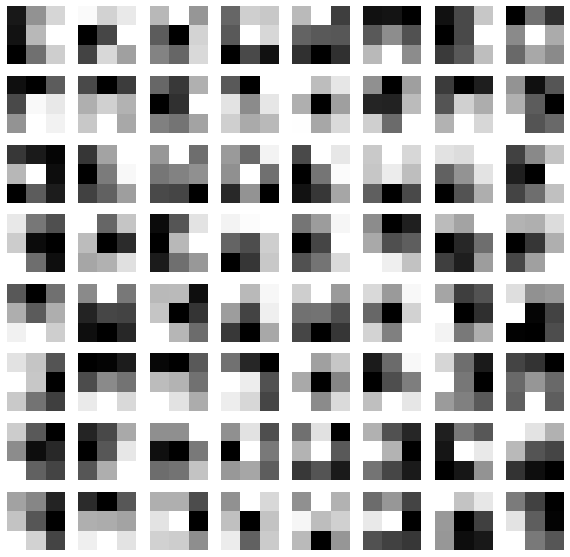

In [ ]:
# visualize the first conv layer filters
plt.figure(figsize=(10, 10))
for i, filter in enumerate(model_weights[0]):
    plt.subplot(8, 8, i+1) # (8, 8) because in Conv2d we have 3x3 filters and total of 64 (see printed shapes)
    plt.imshow(filter[0, :, :].detach(), cmap='gray')
    plt.axis('off')
plt.show()

In [ ]:
len(model_weights[0])

64

In [ ]:
conv_layers

[Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))]

In [ ]:
model_weights[0].shape

torch.Size([64, 3, 3, 3])

# Load the ResNet-50 Model

In [ ]:
model = models.resnet50(pretrained=True)
print(model)
model_weights = [] # we will save the conv layer weights in this list
conv_layers = [] # we will save the 49 conv layers in this list
# get all the model children as list
model_children = list(model.children())

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
counter = 0
# append all the conv layers and their respective weights to the list
for i in range(len(model_children)):
    if type(model_children[i]) == nn.Conv2d:
        counter += 1
        model_weights.append(model_children[i].weight)
        conv_layers.append(model_children[i])
    elif type(model_children[i]) == nn.Sequential:
        for j in range(len(model_children[i])):
            for child in model_children[i][j].children():
                if type(child) == nn.Conv2d:
                    counter += 1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
print(f"Total convolutional layers: {counter}")

Total convolutional layers: 49


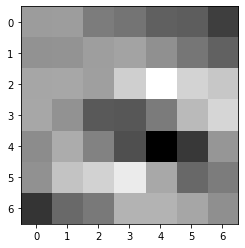

In [ ]:
plt.imshow(model_weights[0][0][0,:,:].detach(), cmap='gray')

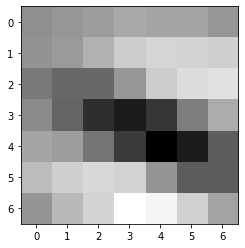

In [ ]:
plt.imshow(model_weights[0][0][2,:,:].detach(), cmap='gray')


# Visualize The First Convolutional Layer Filters

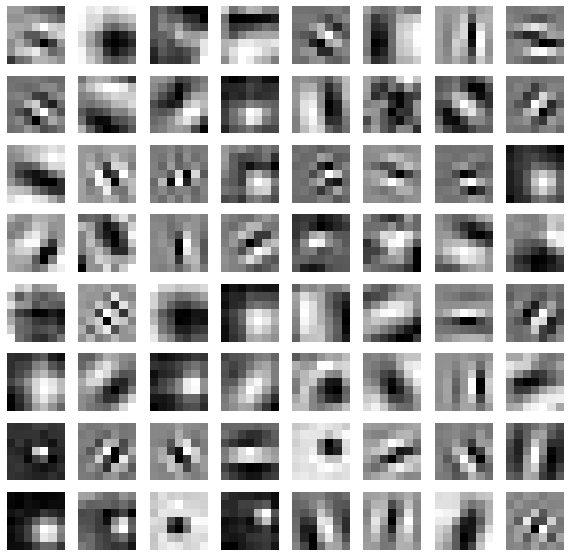

In [ ]:
# visualize the first conv layer filters
plt.figure(figsize=(10, 10))
for i, filter in enumerate(model_weights[0]):
    plt.subplot(8, 8, i+1) # (8, 8) because in conv0 we have 7x7 filters and total of 64 (see printed shapes)
    plt.imshow(filter[0, :, :].detach(), cmap='gray')
    plt.axis('off')
plt.show()

In [ ]:
activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

# Load Image and Define the Transform

In [ ]:
import cv2
img_path = '/content/sample_data/Koala.jpg'
data = cv2.imread(img_path)
# data=data.to(device)

data = cv.cvtColor(data, cv.COLOR_BGR2RGB)

# define the transforms
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((512, 512)),
    transforms.ToTensor(),
])
data = np.array(data)
# apply the transforms
data = transform(data)
print(data.size())
# unsqueeze to add a batch dimension
data = data.unsqueeze(0)
print(data.size())

# pass the image through all the layers
results = [conv_layers[0](data)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results
outputs

torch.Size([3, 512, 512])
torch.Size([1, 3, 512, 512])


[tensor([[[[-7.1556e-01, -6.6635e-01, -6.6109e-01,  ..., -6.8433e-01,
            -6.8288e-01, -3.4062e-01],
           [-2.2268e-02, -1.8307e-02, -1.9823e-02,  ..., -4.8098e-02,
            -1.5821e-02, -5.4621e-02],
           [-5.3411e-02, -1.2253e-02, -4.0946e-02,  ..., -5.1310e-02,
            -9.1852e-02, -6.9445e-02],
           ...,
           [-5.4818e-02, -1.0808e-02, -1.2682e-01,  ..., -4.7080e-02,
            -1.9291e-02, -5.5851e-02],
           [-1.0249e-01, -1.0404e-01,  6.6262e-02,  ..., -7.2599e-02,
            -8.0276e-02, -6.3155e-02],
           [-7.1306e-01, -1.5887e+00, -1.8494e+00,  ..., -8.8387e-01,
            -8.8767e-01, -1.0339e+00]],
 
          [[ 2.5562e-02,  2.1405e-02,  1.7462e-02,  ...,  2.3916e-01,
             2.0723e-01,  1.4615e-01],
           [ 2.6151e-02,  4.1045e-02,  4.9033e-02,  ...,  2.7714e-01,
             2.5828e-01,  1.8432e-01],
           [ 6.8970e-02,  7.3076e-02,  7.9033e-02,  ...,  2.6341e-01,
             2.7708e-01,  2.0662e-01],


# Visualize Feature Maps of the First Conv Layer

---



torch.Size([64, 256, 256])
Saving layer 0 feature maps...


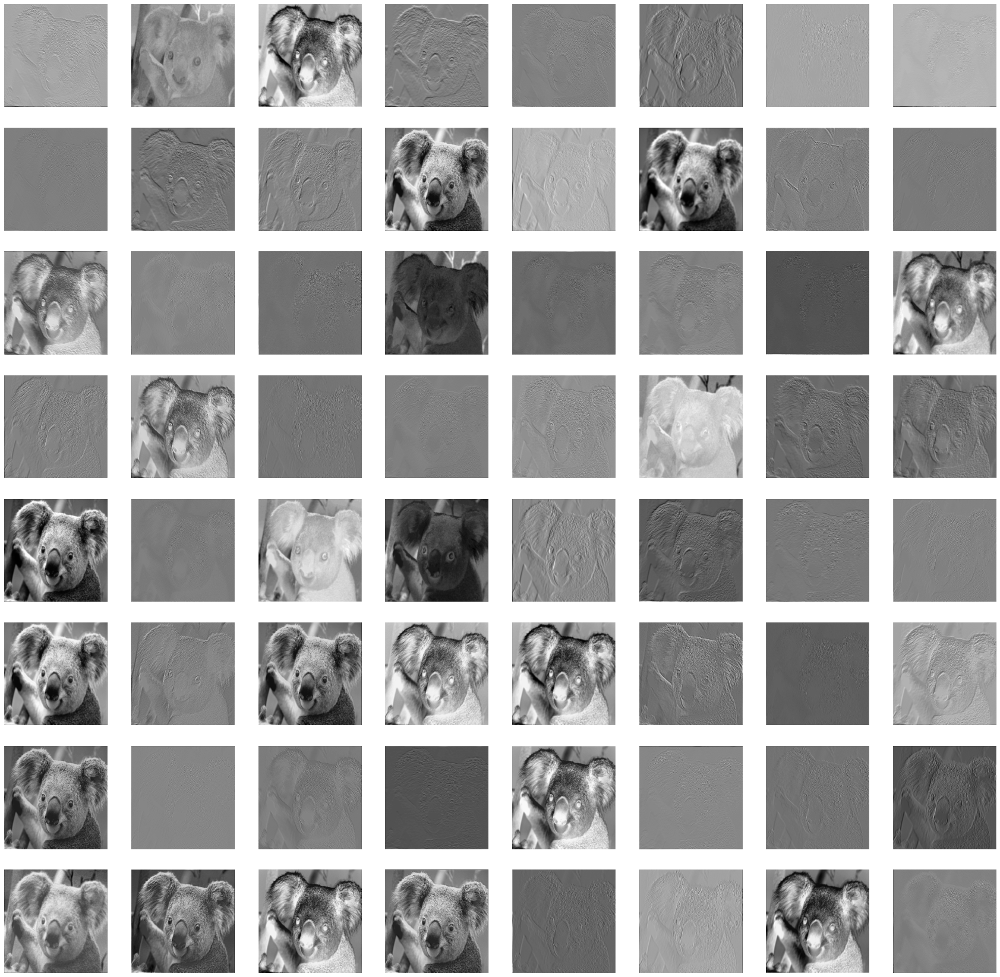

torch.Size([64, 256, 256])
Saving layer 1 feature maps...


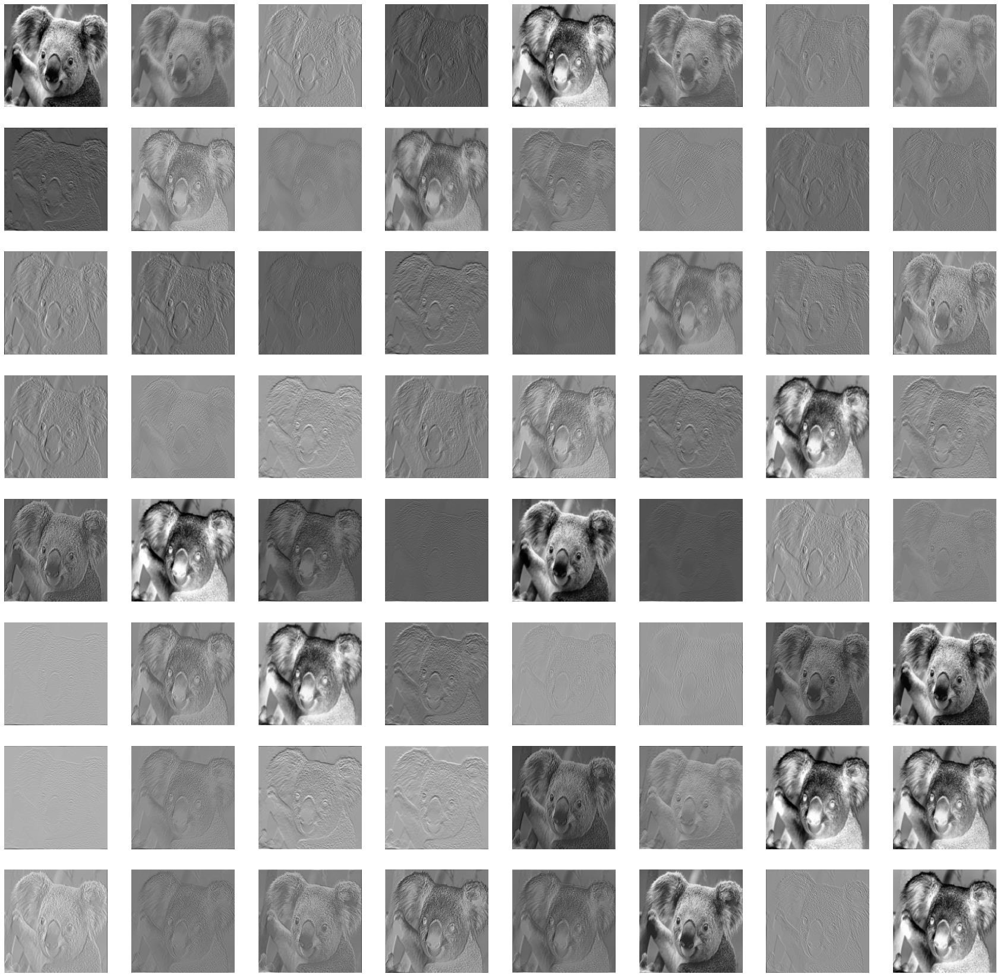

torch.Size([64, 256, 256])
Saving layer 2 feature maps...


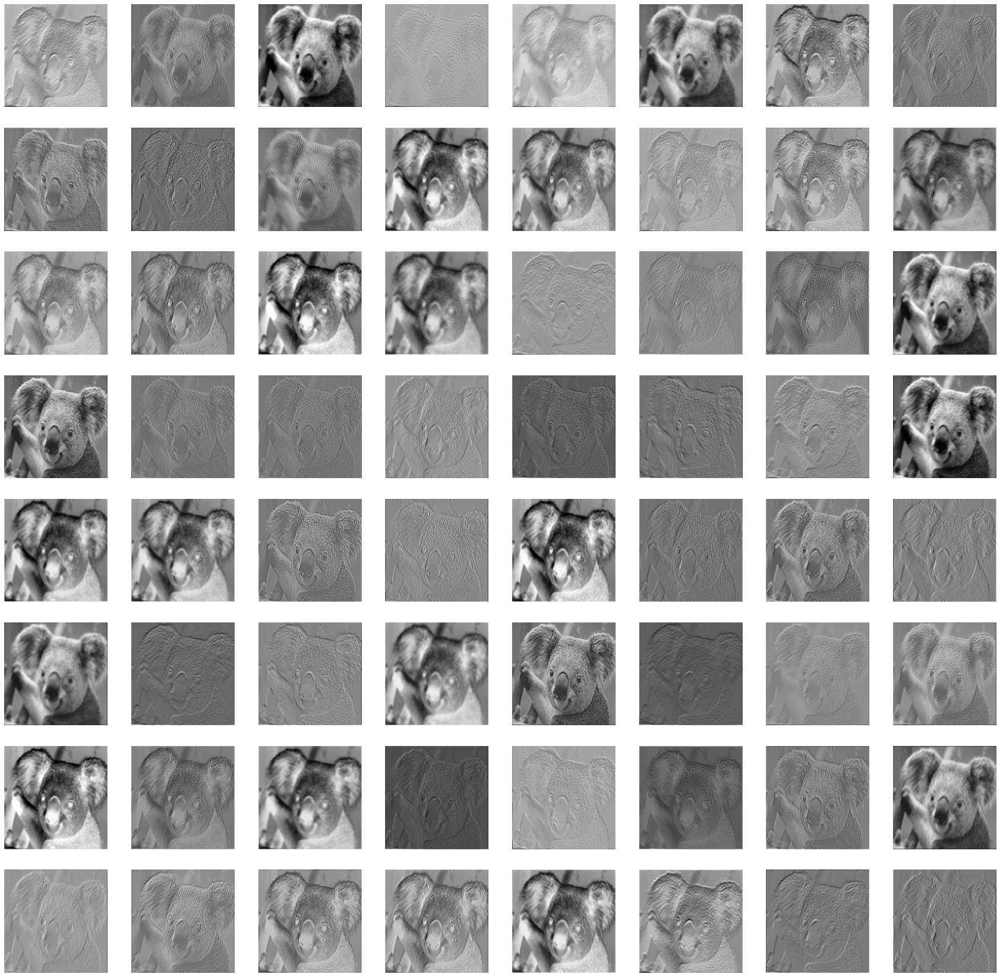

torch.Size([256, 256, 256])
Saving layer 3 feature maps...


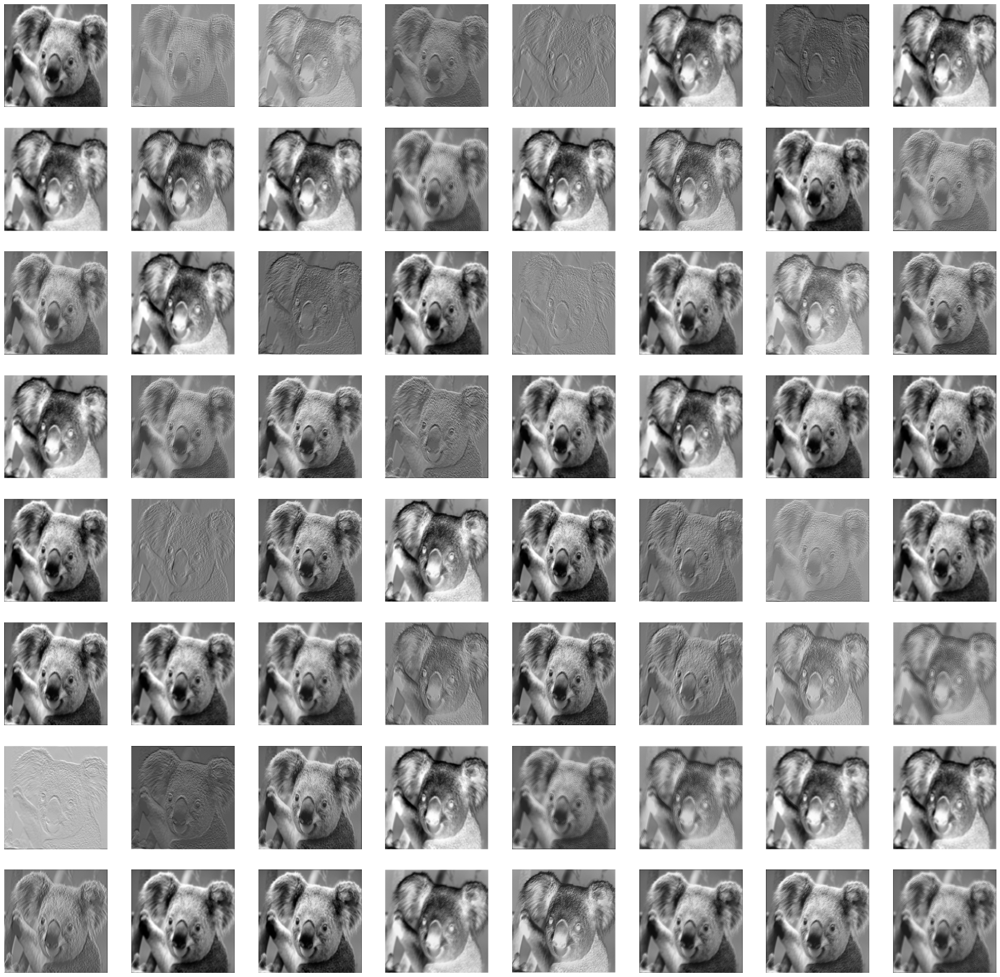

torch.Size([64, 256, 256])
Saving layer 4 feature maps...


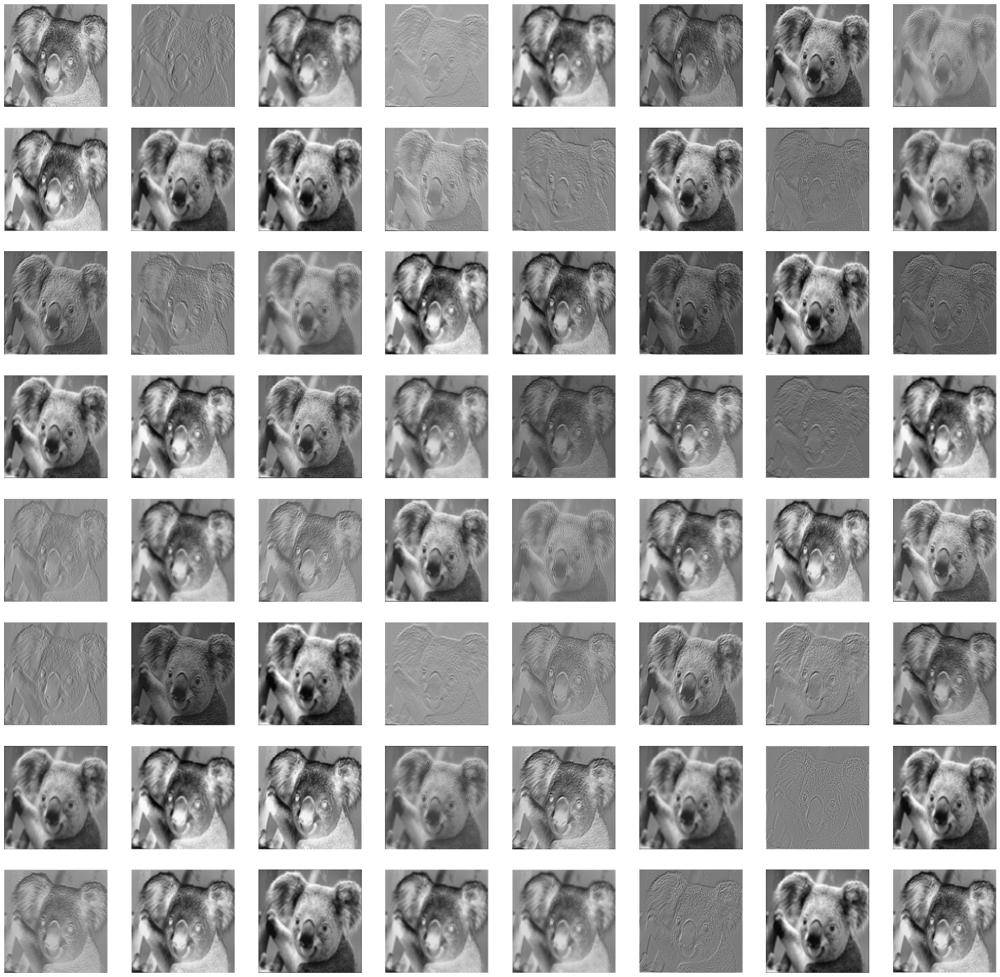

torch.Size([64, 256, 256])
Saving layer 5 feature maps...


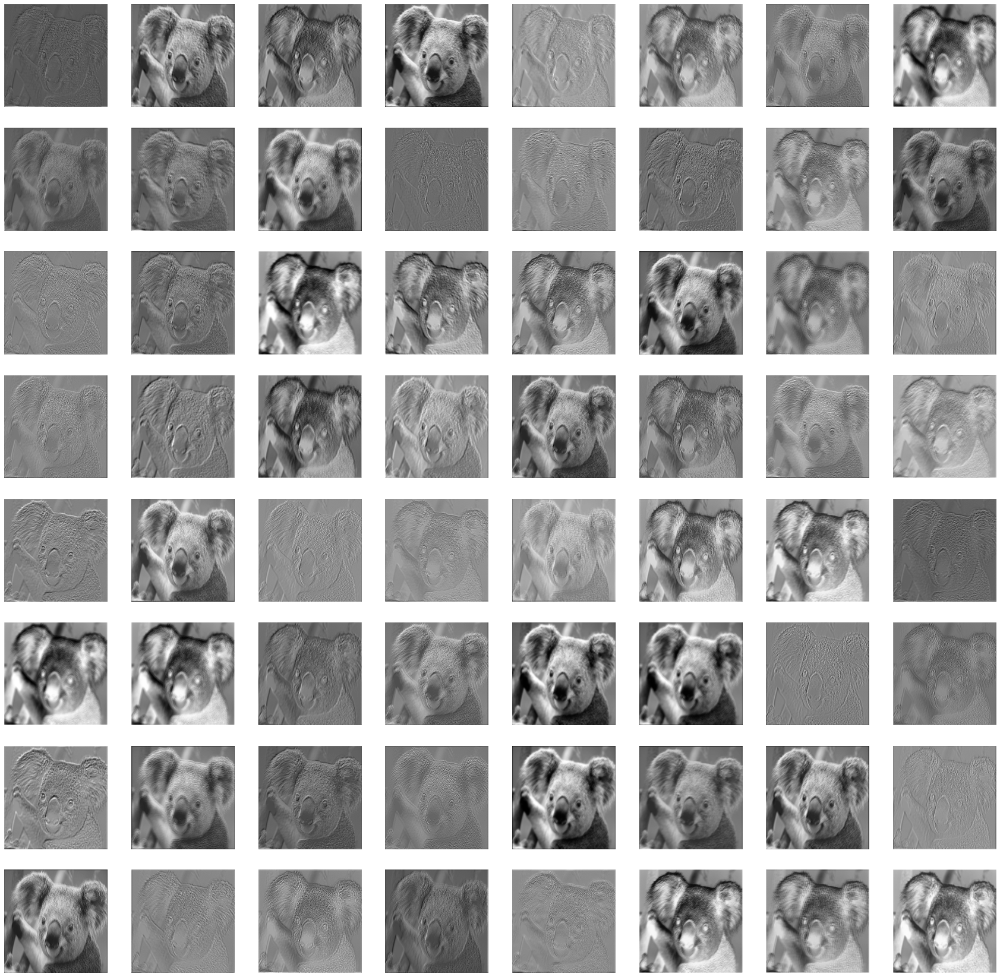

torch.Size([256, 256, 256])
Saving layer 6 feature maps...


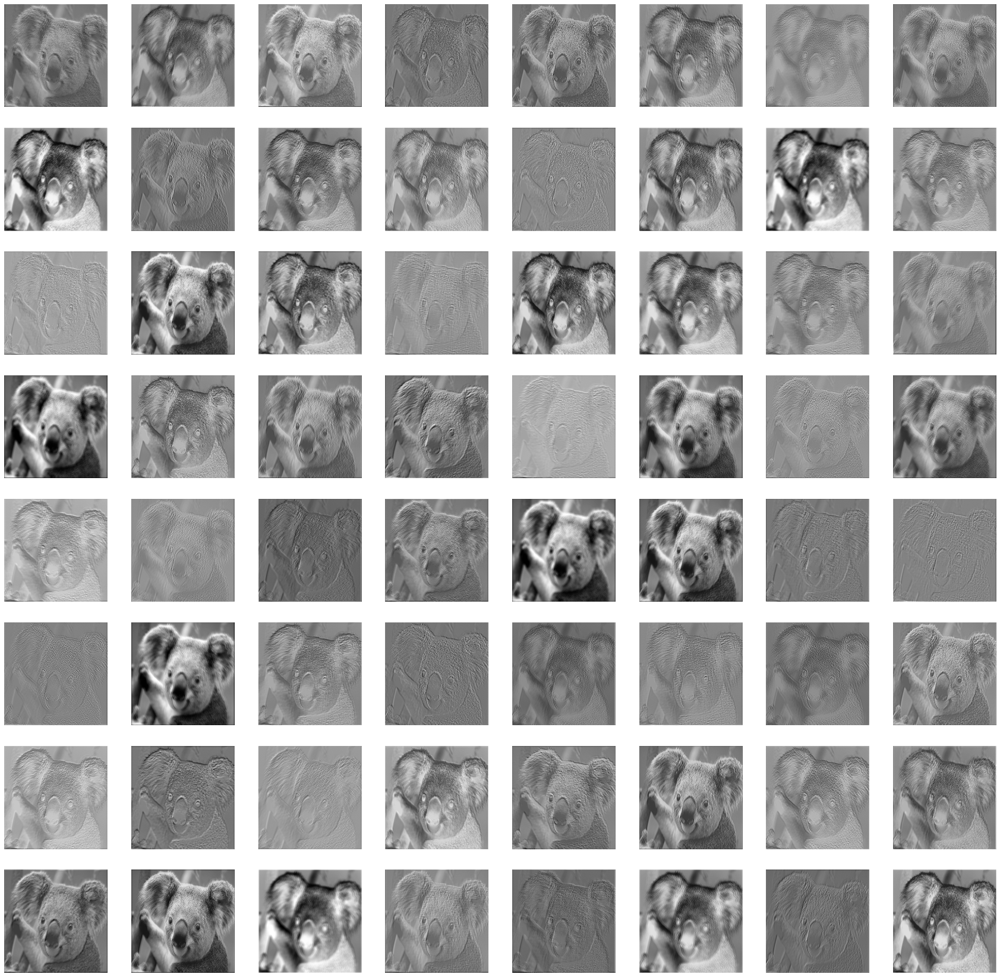

torch.Size([64, 256, 256])
Saving layer 7 feature maps...


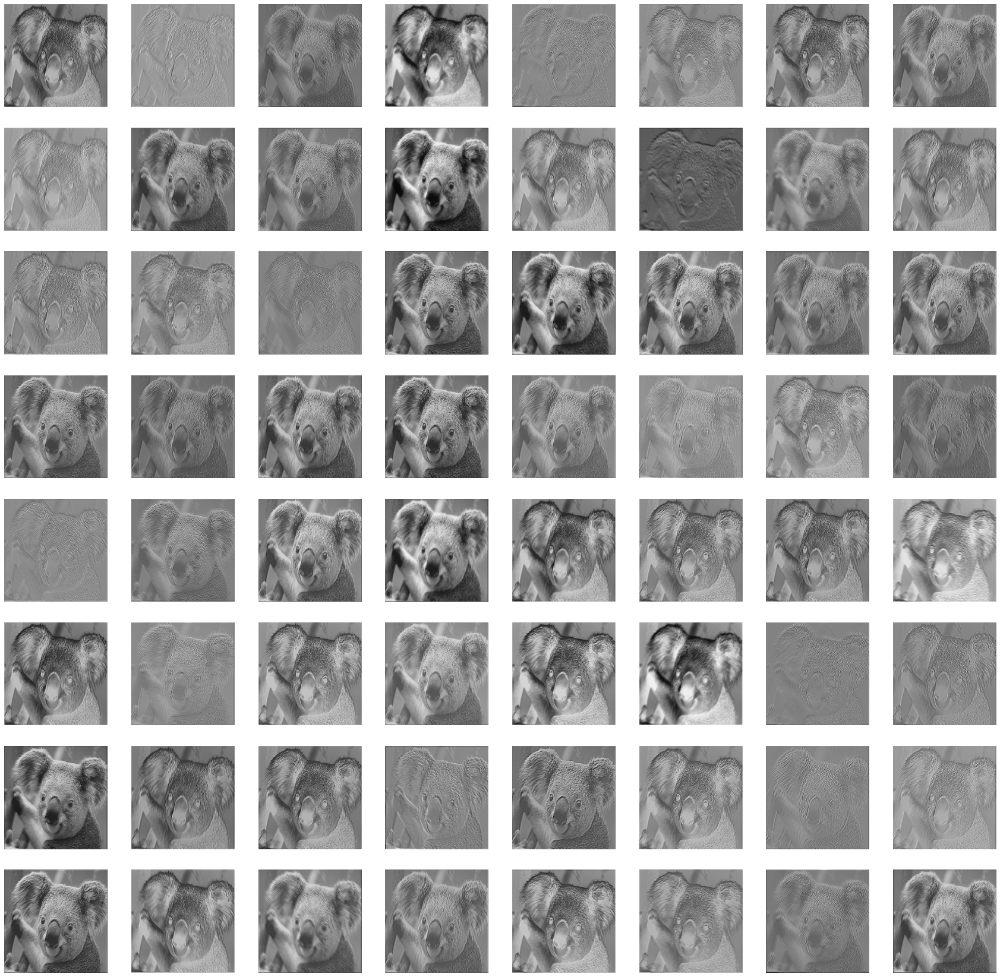

torch.Size([64, 256, 256])
Saving layer 8 feature maps...


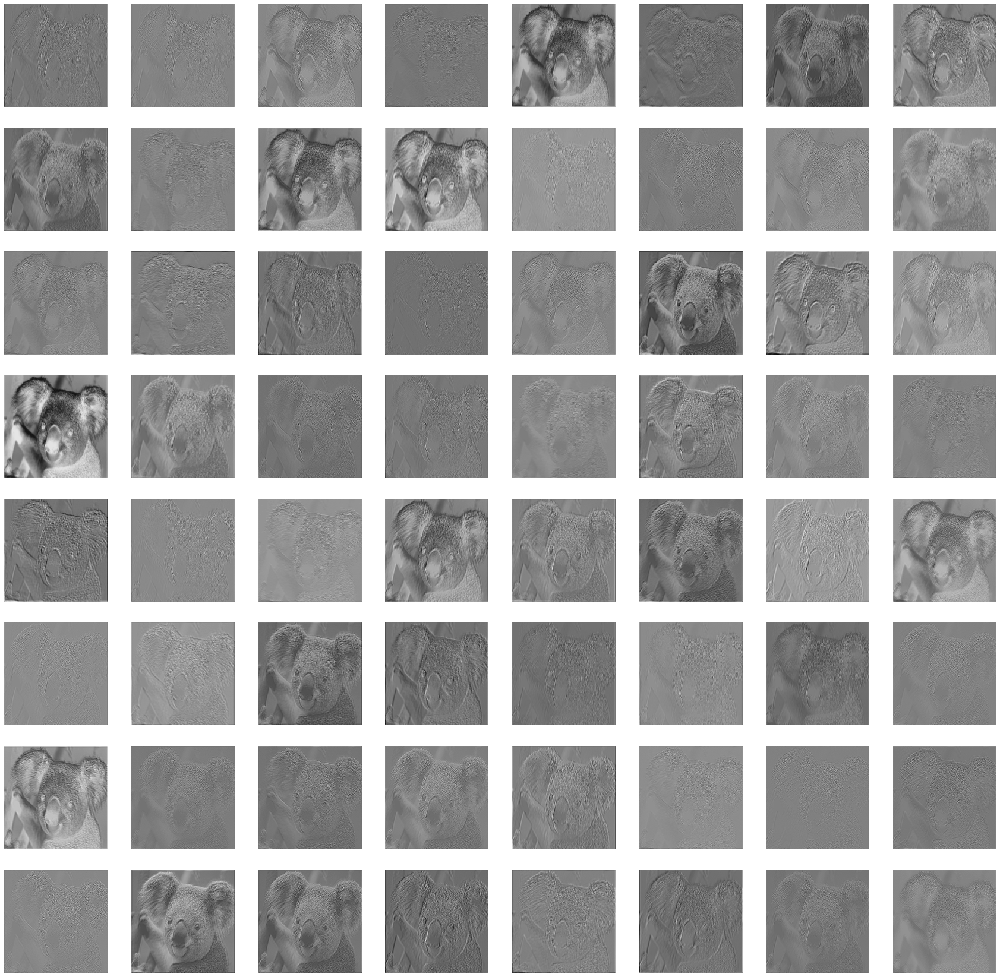

torch.Size([256, 256, 256])
Saving layer 9 feature maps...


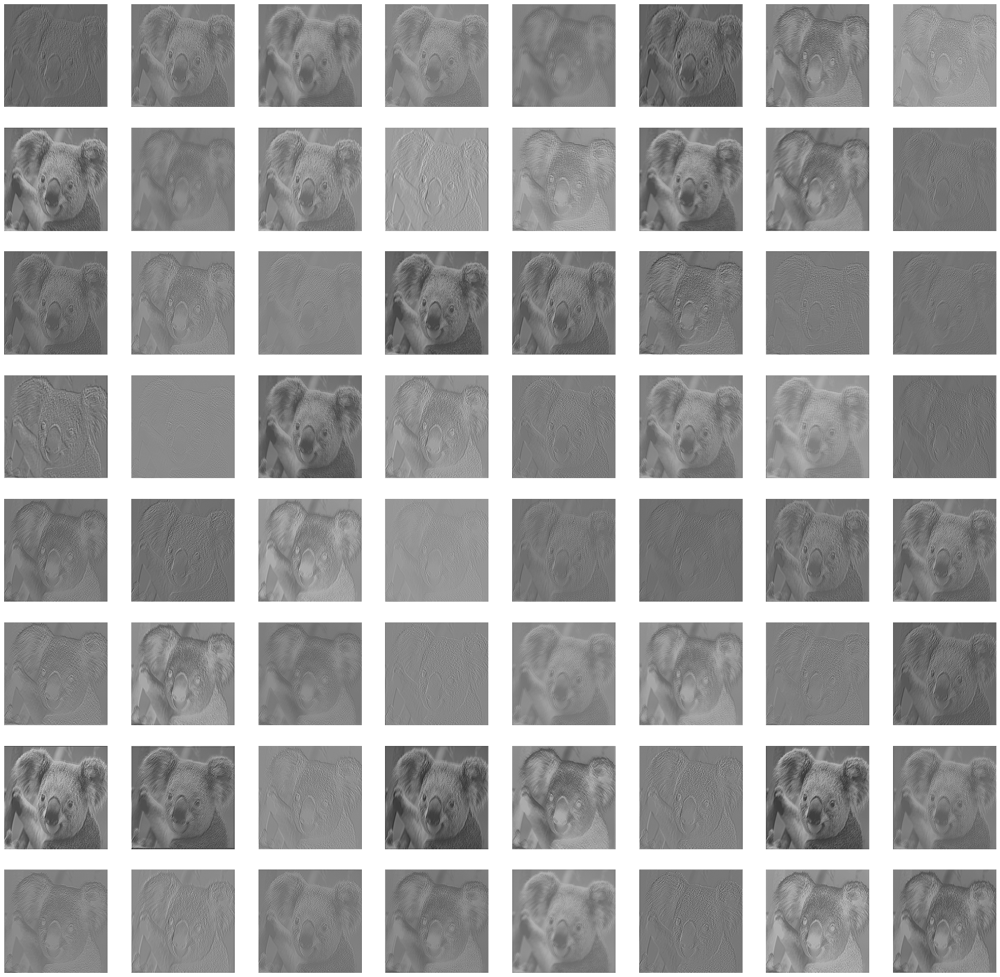

torch.Size([128, 256, 256])
Saving layer 10 feature maps...


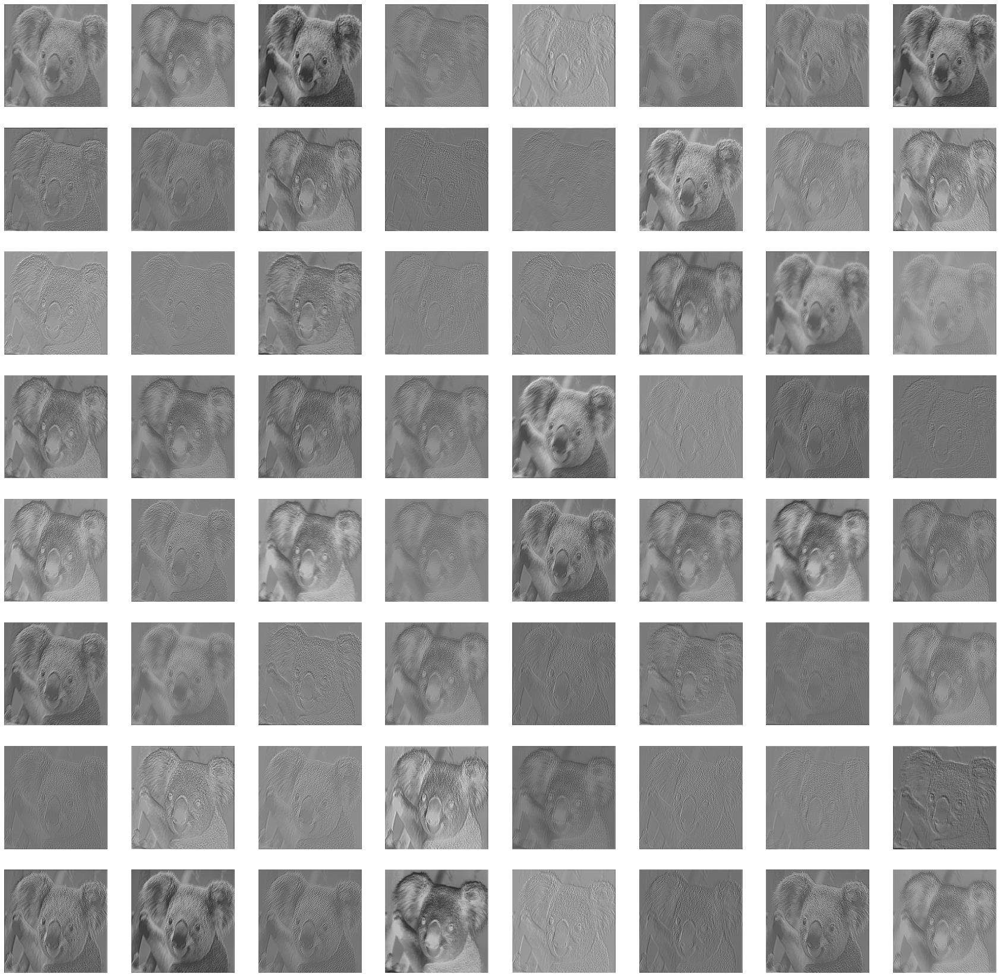

torch.Size([128, 128, 128])
Saving layer 11 feature maps...


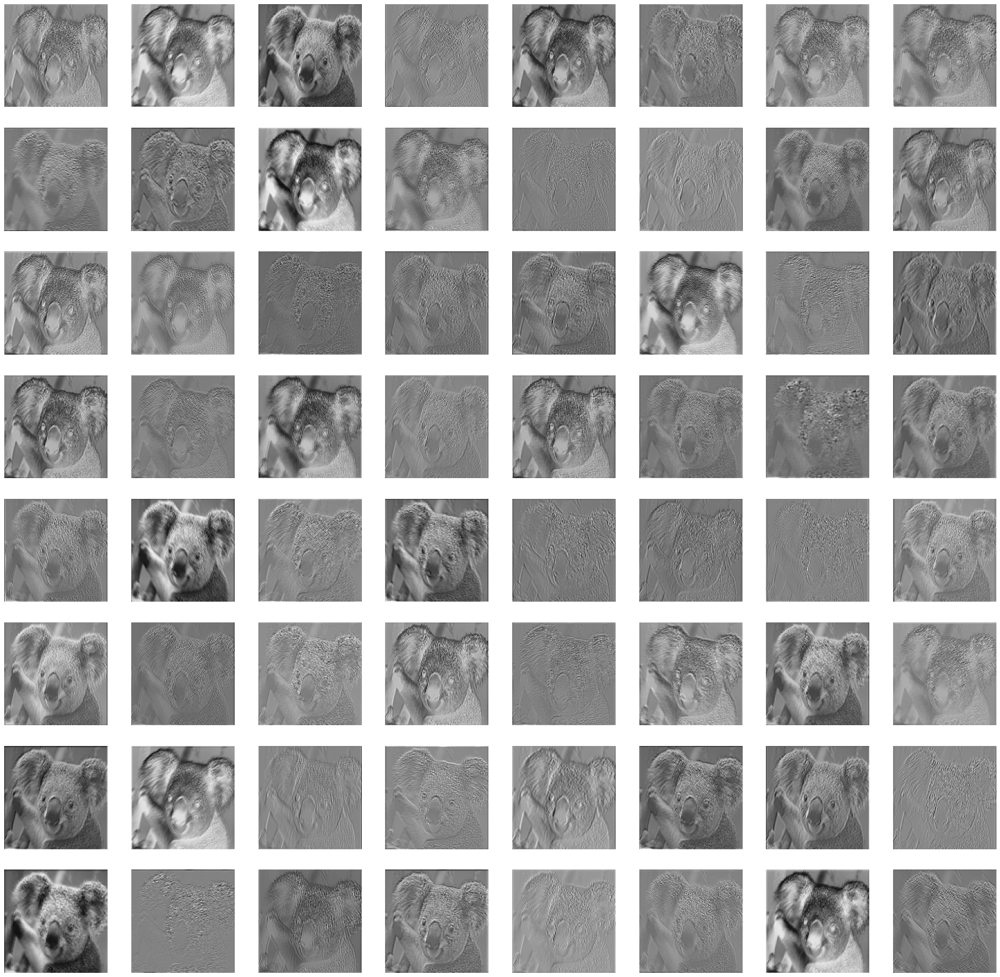

torch.Size([512, 128, 128])
Saving layer 12 feature maps...


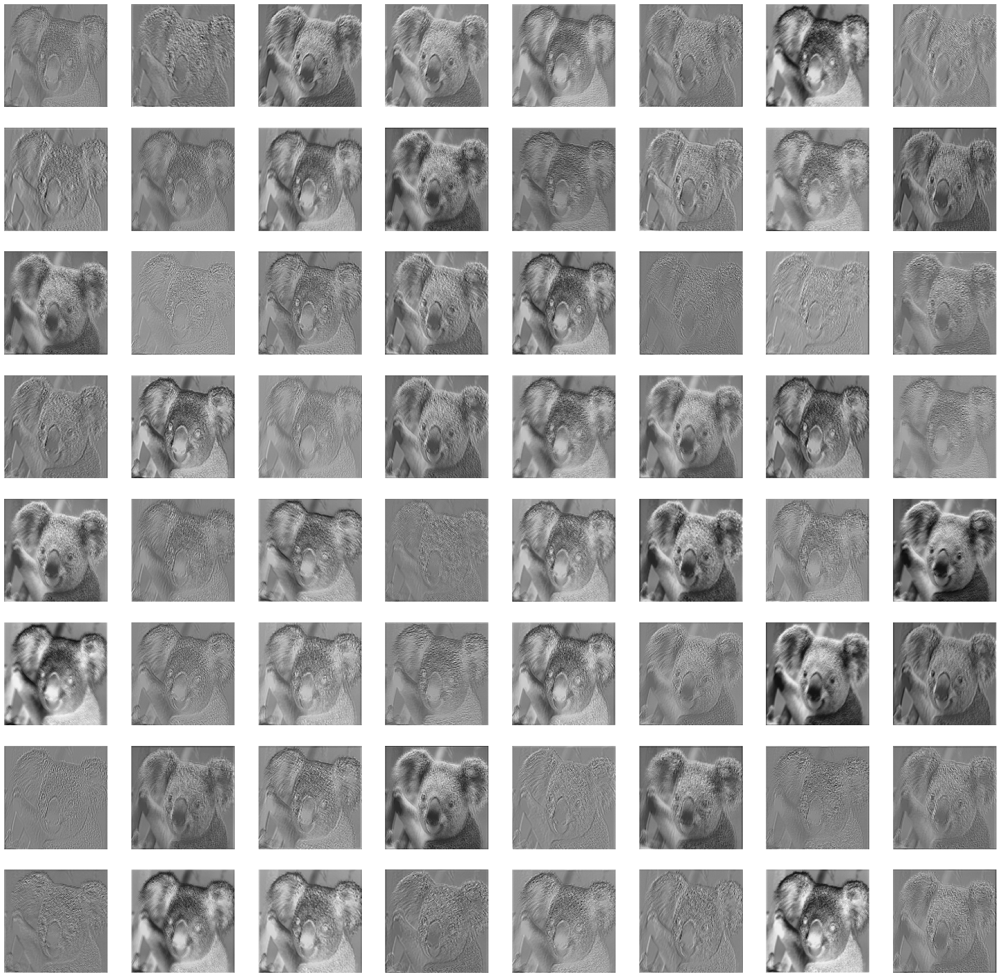

torch.Size([128, 128, 128])
Saving layer 13 feature maps...


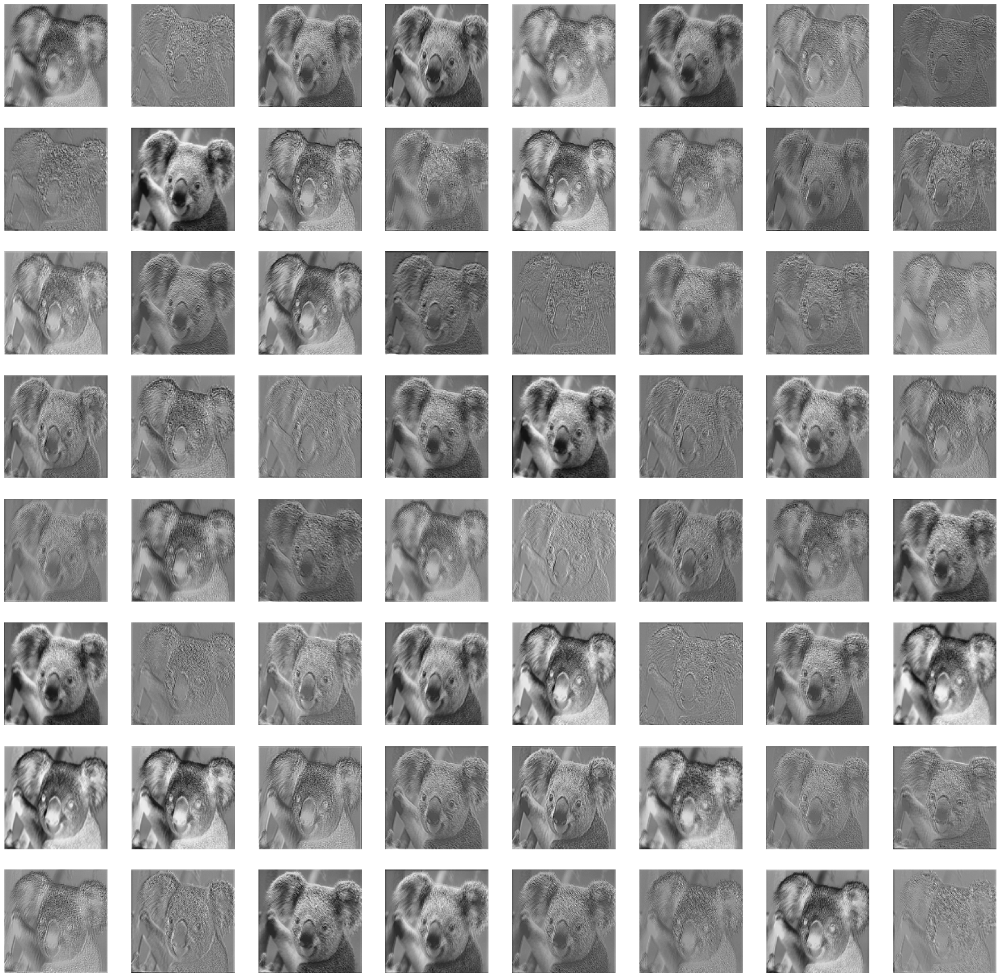

torch.Size([128, 128, 128])
Saving layer 14 feature maps...


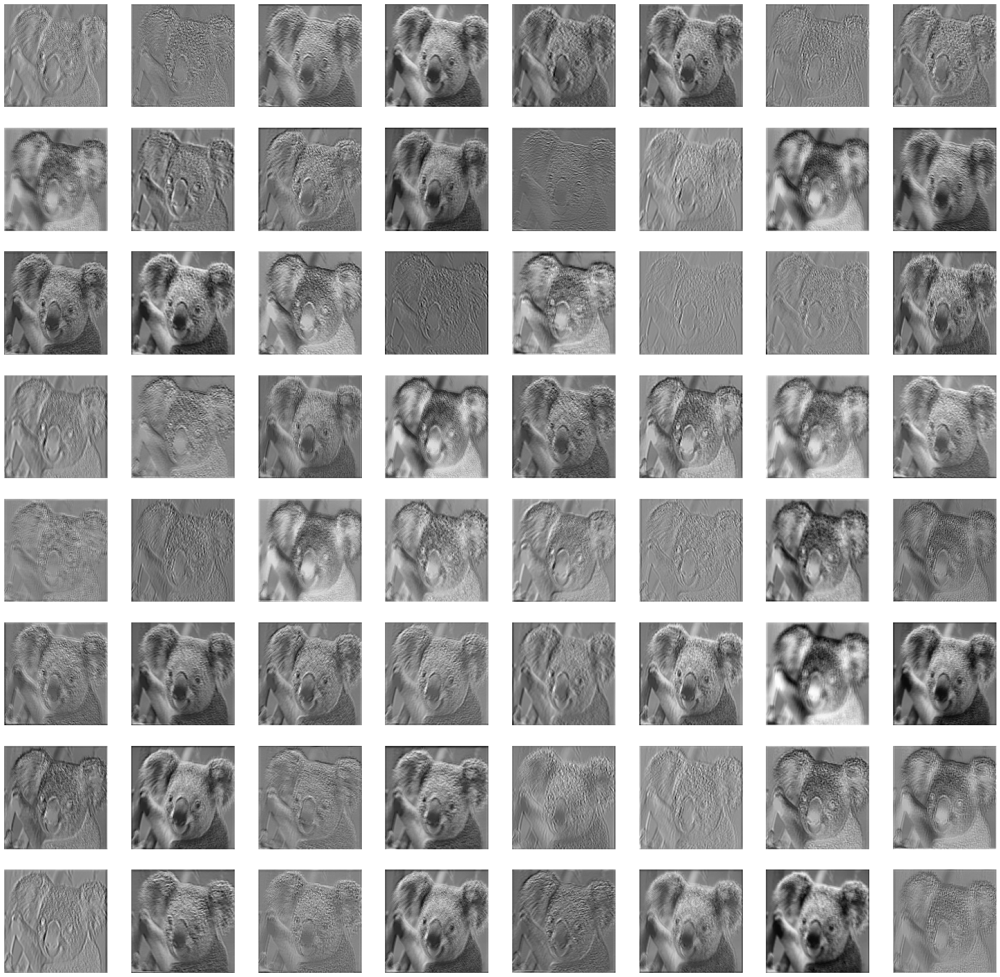

torch.Size([512, 128, 128])
Saving layer 15 feature maps...


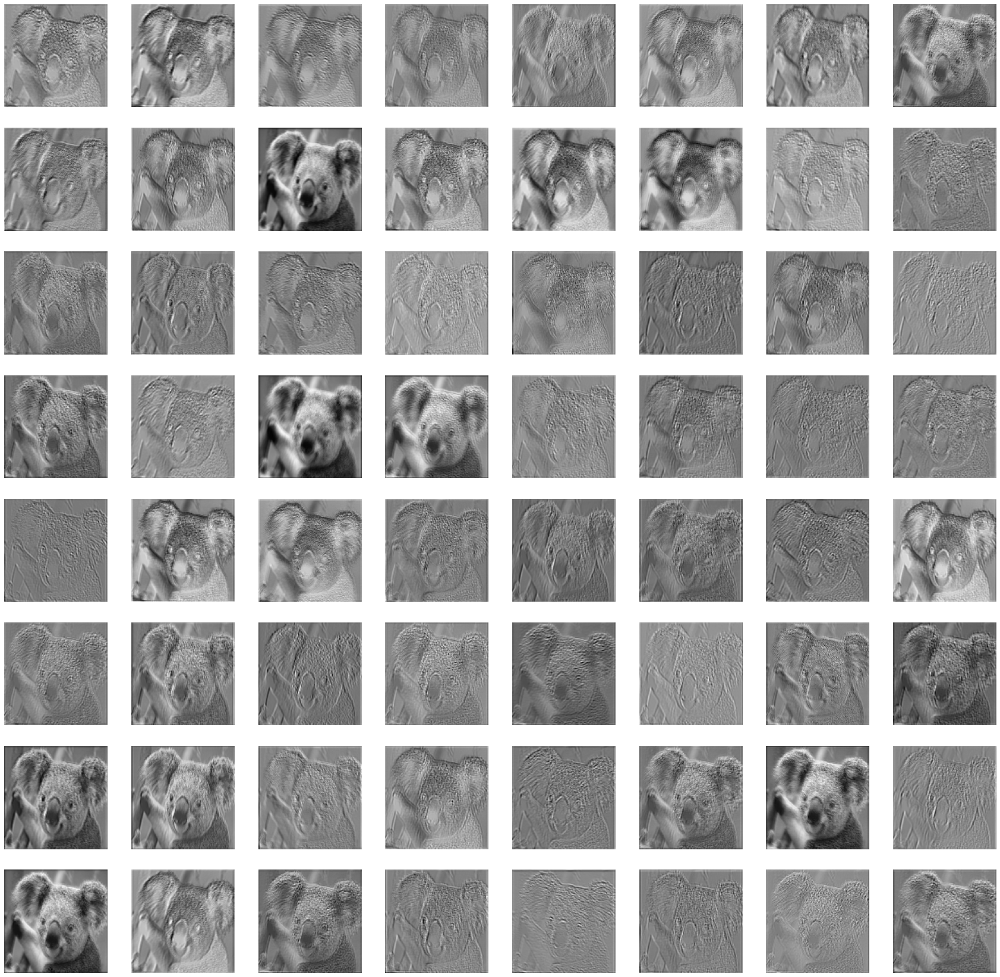

torch.Size([128, 128, 128])
Saving layer 16 feature maps...
Buffered data was truncated after reaching the output size limit.

In [ ]:
for num_layer in range(len(outputs)):
    plt.figure(figsize=(30, 30))
    layer_viz = outputs[num_layer][0, :, :, :]
    layer_viz = layer_viz.data
    print(layer_viz.size())
    for i, filter in enumerate(layer_viz):
        if i == 64: # we will visualize only 8x8 blocks from each layer
            break
        plt.subplot(8, 8, i + 1)
        plt.imshow(filter, cmap='gray')
        plt.axis("off")
    print(f"Saving layer {num_layer} feature maps...")
    # plt.savefig(f"../outputs/layer_{num_layer}.png")
    plt.show()
    # plt.close()

In [ ]:
resnet18 = models.resnet18(pretrained=True)